In [15]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation
from datetime import datetime

%matplotlib inline

In [16]:
# Load .env enviroment variables
load_dotenv()

True

Part 1 - Personal Finance Planner

Collect Crypto Prices Using the requests Library


In [17]:
# Set current amount of crypto assets
tickers = ["BTC", "ETH"]
BTC = 1.2
ETH = 5.3

In [18]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=USD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=USD"

In [19]:
# Fetch current BTC price
my_btc = 1.2 

# Fetch current ETH price
my_eth = 5.3

# Compute current value of my crpto
my_btc_value = requests.get(btc_url).json()["data"]["1"]["quotes"]["USD"]["price"] 
my_eth_value = requests.get(eth_url).json()["data"]["1027"]["quotes"]["USD"]["price"] 

crypto= (my_btc_value*my_btc)+(my_eth_value*my_eth)

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

The current value of your 1.2 BTC is $11550.69
The current value of your 5.3 ETH is $379.00


 Collect Investments Data Using Alpaca: SPY (stocks) and AGG (bonds)
 

In [20]:
# Current amount of shares
my_spy= 50
my_agg = 200

In [21]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("APCA_API_KEY")
alpaca_secret_key = os.getenv("APCA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)

In [23]:
type(alpaca_api_key)

str

In [33]:
# Format current date as ISO format
today = pd.Timestamp(datetime.today()).isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
shares_df = api.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

close_price= shares_df.xs("close", axis='columns', level=1)
# Preview DataFrame
close_price

,AGG,SPY
time,,
2020-05-27 00:00:00-04:00,117.400,303.48
2020-05-28 00:00:00-04:00,117.330,302.96
2020-05-29 00:00:00-04:00,117.670,304.16
2020-06-01 00:00:00-04:00,117.365,305.58
2020-06-02 00:00:00-04:00,117.450,308.13
...,...,...
2020-10-09 00:00:00-04:00,117.705,346.84
2020-10-12 00:00:00-04:00,117.930,352.43
2020-10-13 00:00:00-04:00,118.010,350.15


In [35]:
# Compute the current value of shares
spy_last_val = close_price["SPY"][-1] 
agg_last_val = close_price["AGG"][-1] 

spy_value= my_spy * spy_last_val
agg_value = my_agg * agg_last_val

shares = spy_value + agg_value

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${agg_value:0.2f}")

The current value of your 50 SPY shares is $17375.50
The current value of your 200 AGG shares is $23594.00


Savings Health Analysis

In [50]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
savings_df = pd.DataFrame([shares, crypto], columns=['amount'], index=["shares", "crypto"])

# Display savings DataFrame
display(savings_df)

,amount
shares,40969.500
crypto,15869.528


<AxesSubplot:ylabel='amount'>

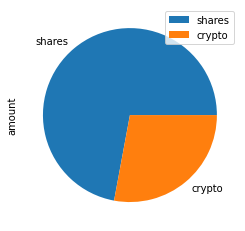

In [51]:
# Plot savings pie chart
savings_df.plot(kind="pie", y="amount")

In [53]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
savings = int(crypto + shares)

# Validate saving health
   
if savings > emergency_fund:
    print("Congratulations! You have enough money in your emergency fund.")

elif savings== emergency_fund:
    
    print("Congratulating the person on reaching this financial goal.")

elif savings < emergency_fund:
    close_goal = savings - emergency_fund
    print(f"You are ${close_goal} from reaching the goal.")


Congratulations! You have enough money in your emergency fund.


Part 2 - Retirement Planning

Monte Carlo Simulation

In [54]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-14', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-14', tz='America/New_York').isoformat()

In [55]:
# Get 5 years' worth of historical data for SPY and AGG
df_stock_data = api.get_barset(tickers,
    timeframe,
    start=start_date,
    end=end_date
).df 
# Display sample data
df_stock_data.head()

AGG                                       \
                             open      high       low   close   volume   
time                                                                     
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                              SPY                                      
                             open    high       low   close    volume  
time                                                                   
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395

In [83]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
shares_weight = [.40, .60]
tickers= ["SPY", "AGG"]

num_sims = 500
MC_stocks = MCSimulation(
    portfolio_data = df_stock_data,
    weights=shares_weight,
    num_simulation = num_sims,
    num_trading_days = 252*30
    
)


In [84]:
# Printing the simulation input data
MC_stocks.portfolio_data.head()

AGG                                       \
                             open      high       low   close   volume   
time                                                                     
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                                           SPY                            \
                          daily_return    open    high       low   close   
time                                                                       
2015-10-14 00:00:00-04:00          NaN  200.18  200.87  198.9400  199.27   
2015-10-15 00:00:00-04:00    -0.001272  200.08  202.34  199.6400  202.33   
2015-10-16 00:00:00-04:00    -0.001001  202.83  203.29  201.9200  203.14   
2015-10-19 00:00:00-04:00     0.000638  202.50  203.37  202.1300  203.33   
2015-10-20 00:00:00-04:00    -0.001821  202.85  203.84  202.5471  203.07   

                                                  
                             volume daily_return  
time                                              
2015-10-14 00:00:00-04:00  82856686          NaN  
2015-10-15 00:00:00-04:00  96008389     0.015356  
2015-10-16 00:00:00-04:00  79323870     0.004003  
2015-10-19 00:00:00-04:00  61255929     0.000935  
2015-10-20 00:00:00-04:00  60081395    -0.001279

In [85]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_stocks.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.000004,1.004746,0.997199,0.998182,1.008539,1.002516,1.013254,0.996236,1.009242,0.993505,...,0.997223,0.995926,1.002086,0.982962,1.012224,1.001481,0.994065,0.993945,1.000937,1.011635
2,0.996266,0.998251,0.997003,0.995225,1.003876,0.997108,1.007946,1.000770,1.012809,0.991619,...,1.008284,0.996031,0.998998,0.974672,1.017545,0.999001,0.998127,0.996145,0.984315,1.018798
3,0.998679,0.993350,0.992986,0.985785,1.016080,0.996216,1.006482,1.002125,1.016637,0.996247,...,1.000495,0.991182,1.001907,0.958692,1.018903,0.989867,1.001019,0.993594,0.988181,1.023617
4,0.993340,1.002778,0.982912,0.990318,1.019277,0.995819,1.012623,1.019740,1.010873,0.995730,...,0.997485,0.993599,1.000420,0.950321,1.020994,0.980587,0.996229,1.000997,0.990387,1.019314
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,3.546016,13.518875,10.542469,14.258535,5.620421,4.708233,8.724128,4.035865,5.273171,8.123449,...,38.506297,11.292823,8.153375,39.664341,10.601340,6.202172,10.292137,29.239902,17.616768,4.985619
7557,3.577205,13.395251,10.606924,14.132317,5.681119,4.701665,8.676882,4.072303,5.259183,8.142578,...,39.034878,11.287417,8.140868,39.038857,10.654014,6.191264,10.316836,29.110840,17.770835,4.983328
7558,3.579392,13.464438,10.643930,14.057175,5.632582,4.705549,8.630131,4.054980,5.274858,8.228436,...,38.878851,11.249339,8.177135,39.148193,10.615387,6.211769,10.405499,29.061663,17.945554,4.995210
7559,3.591642,13.449506,10.643997,14.131223,5.649621,4.650460,8.684852,4.068242,5.191514,8.284876,...,39.035887,11.088882,8.212105,39.374239,10.439500,6.187817,10.338169,29.191372,17.838908,5.045884


<AxesSubplot:title={'center':'500 Simulations of Cumulative Portfolio Return Trajectories Over the Next 7560 Trading Days.'}>

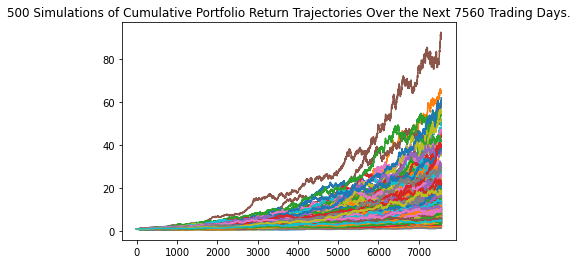

In [86]:
# Plot simulation outcomes
MC_stocks.plot_simulation()

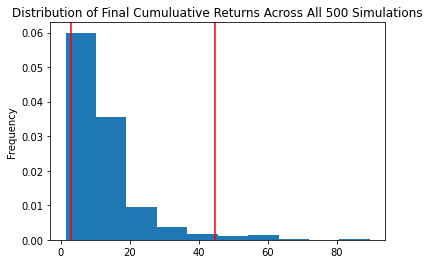

In [87]:
# Plot probability distribution and confidence intervals
distribution_plot = MC_stocks.plot_distribution()

Retirement Analysis

In [88]:
# Fetch summary statistics from the Monte Carlo simulation results
stocks_results= MC_stocks.summarize_cumulative_return()

# Print summary statistics
print(stocks_results)

count           500.000000
mean             12.676951
std              10.424177
min               1.454776
25%               6.152094
50%              10.064763
75%              15.360003
max              89.512500
95% CI Lower      2.915647
95% CI Upper     44.554853
Name: 7560, dtype: float64


Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a $20,000 initial investment.

In [89]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
stocks_ci_lower = round(stocks_results[8]*20000,2)
stocks_ci_upper = round(stocks_results[9]*20000,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${stocks_ci_lower} and ${stocks_ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $58312.94 and $891097.06


Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a 50% increase in the initial investment.

In [90]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
stocks_ci_lower = round(stocks_results[8]*30000,2)
stocks_ci_upper = round(stocks_results[9]*30000,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${stocks_ci_lower} and ${stocks_ci_upper}")worki

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $87469.41 and $1336645.59
